In [4]:
import matplotlib.pyplot as plt
import numpy as np

In [311]:
def ReLU(x):
    return max(0, x)

def grad_ReLU(x):
    return float(x>0)

def LeakyReLU(x):
    return x if x > 0 else 0.01 * x

def grad_LeakyReLU(x):
    return 1.0 if x > 0 else 0.01

def sigmoid(x):
    x = np.clip(x, -500, 500)
    return 1/(1+np.exp(-x))

def grad_sigmoid(x):
    y = sigmoid(x)
    return y * (1 - y)

def MSE(output, target):
    return np.mean((target - output)**2)

def grad_MSE(output, target):
    return -2 * (target - output) / output.size

def MAE(output, target):
    return np.mean(np.abs(target - output))

def grad_MAE(output, target):
    return np.sign(output - target) / output.size

def cross_entropy(output, target):
    epsilon = 1e-15
    output = np.clip(output, epsilon, 1 - epsilon)
    return -np.mean(target * np.log(output) + (1 - target) * np.log(1 - output))

def grad_cross_entropy(output, target):
    epsilon = 1e-15
    output = np.clip(output, epsilon, 1 - epsilon)
    return - (target / output) + ((1 - target) / (1 - output))


In [312]:
class Neuron:
    def __init__(self, nb_inputs:int, activation, grad_activation):
        self.biais = np.random.randn() * 0.1
        self.weights = np.random.randn(nb_inputs) 
        self.activation = activation
        self.grad_activation = grad_activation
        self.grad_biais = 0
        self.grad_weight = np.zeros(nb_inputs)  
        self.last_input = 0
        self.last_output = 0
        self.last_sum = 0
    
    def somme(self, x):
        return np.dot(self.weights, x) + self.biais

    def forward(self, x):
        self.last_input = x
        self.last_sum = self.somme(x)
        self.last_output = self.activation(self.last_sum)
        return self.last_output

    
    def backward(self, grad_output):
        grad_activ = self.grad_activation(self.last_sum) #da_dz
        delta = grad_output * grad_activ #dl_dz 
        self.grad_biais = delta
        self.grad_weight = delta * self.last_input #dl_dz @ dz_dw
        grad_input = delta * self.weights #dl_dx
        return grad_input


    def update(self, learning_rate:float):
        self.weights -= learning_rate * self.grad_weight
        self.biais -= learning_rate * self.grad_biais
    
    def __str__(self):
        return f"Neurone\nbiais: {self.biais}\nactivation: {self.activation}\n poids: {self.weights}"



In [313]:
class Layer:
    def __init__(self, neurons:list[Neuron]):
        self.neurons = neurons

    def forward(self, x):
        return np.array([n.forward(x) for n in self.neurons])

    def backward(self, grad_output):
        grad_inputs = [n.backward(grad_output[i]) for i, n in enumerate(self.neurons)]
        return np.sum(grad_inputs, axis=0)

    def update(self, learning_rate):
        for n in self.neurons:
            n.update(learning_rate)

    def __str__(self):
        return f"Couche:\n Neurones:{'\n'.join([str(neuron) for neuron in self.neurons])}"

    


In [314]:
class Network:
    def __init__(self, layers:list[Layer], loss, grad_loss):
        self.layers = layers
        self.loss = loss
        self.grad_loss = grad_loss

    def forward(self, x):
        for layer in self.layers:
            x = layer.forward(x)
        return x
            
    def backward(self, output, target):
        grad_loss = self.grad_loss(output, target)
        grad_input = grad_loss
        for layer in self.layers[::-1]:
            grad_input = layer.backward(grad_input)

    def loss(self, output, target):
        return self.loss(output, target)

    def update(self, learning_rate):
        for layer in self.layers:
            layer.update(learning_rate)
    
    def __str__(self):
        return f"Reseau:\n Couches:{'\n'.join([str(layer) for layer in self.layers])}"


In [319]:
class Trainer:
    def __init__(self, network:Network, x:np.array, targets:np.array, learning_rate:float,
                nb_epochs:int, epsilon:int, plot:bool=True, verbose:bool=True,):
        self.network = network
        self.x = x
        self.targets = targets
        self.learning_rate = learning_rate
        self.nb_epochs = nb_epochs
        self.epsilon = epsilon
        self.plot = plot
        self.verbose = verbose
    
    def train(self):
        losses = []
        for epoch in range(self.nb_epochs):
            total_loss = 0
            outputs = []
            for xi, target in zip(self.x, self.targets):
                output = self.network.forward(xi)
                self.network.backward(output, target)
                self.network.update(self.learning_rate)
                total_loss += self.network.loss(output, target)
                outputs.append(output[0])
            loss_epoch = total_loss/len(self.x)
            losses.append(loss_epoch)

            if self.verbose:
                print(f"Epoch {epoch+1} - outputs: {outputs} - Loss: {total_loss / len(self.x)}")

            if loss_epoch < self.epsilon:
                break

               
        
        if self.verbose:
            print(f"targets: {self.targets}")
        
        if self.plot:
            plt.plot(losses)
            plt.xlabel("Époque")
            plt.ylabel(f"Perte")
            plt.title(f"lr={self.learning_rate}")
            plt.grid(True)
            plt.ylim(0, max(1.5, max(losses)))

lr = 1e-05
lr = 0.001
lr = 0.01
lr = 0.1
lr = 1
lr = 10
lr = 100


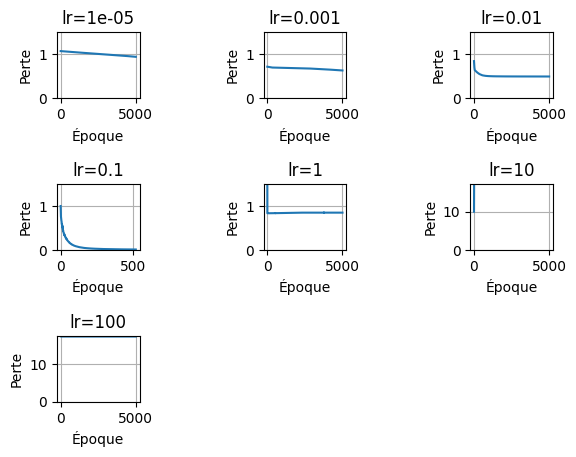

In [321]:
# Probleme XOR

# autant de x que de targets, dim xi = nb_inputs neuron 1ere couche
x = np.array([[0,0], [0,1], [1,0], [1, 1]])

targets = np.array([[0], [1], [1], [0]])

r = [0.00001, 0.001, 0.01, 0.1, 1, 10, 100]

for i, lr in enumerate(r):
    layer1 = Layer([Neuron(nb_inputs=2, activation=LeakyReLU, grad_activation=grad_LeakyReLU) for _ in range(4)])
    layer2 = Layer([Neuron(nb_inputs=4, activation=sigmoid, grad_activation=grad_sigmoid)])
    network = Network([layer1, layer2], loss = cross_entropy, grad_loss = grad_cross_entropy)

    trainer = Trainer(network, x, targets, learning_rate=lr, nb_epochs=5000, epsilon=0.01, plot=True, verbose=False)
    print(f"lr = {lr}")
    plt.subplot(3,3, i+1)
    trainer.train()
    plt.subplots_adjust(wspace=1.5, hspace=1.3)

plt.show()
    





lr = 0.01


100%|██████████| 1000/1000 [00:09<00:00, 109.35it/s]


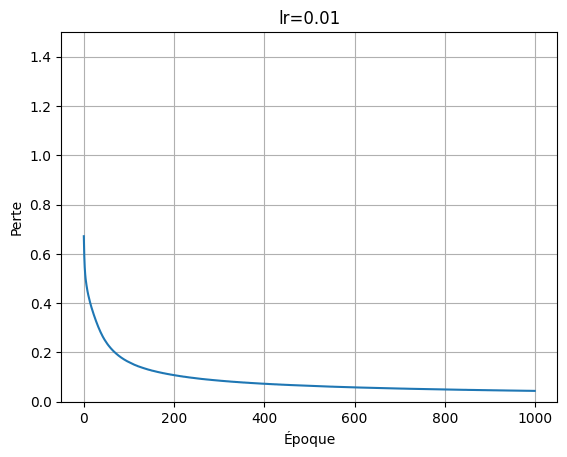

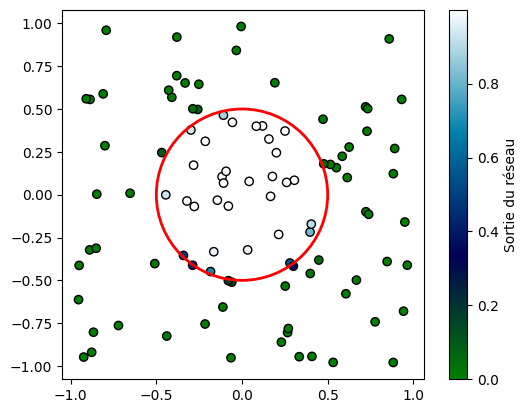

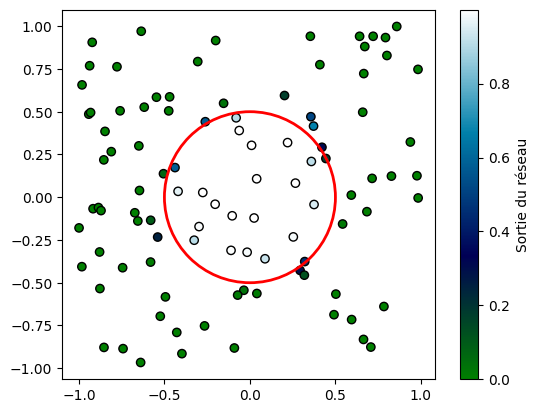

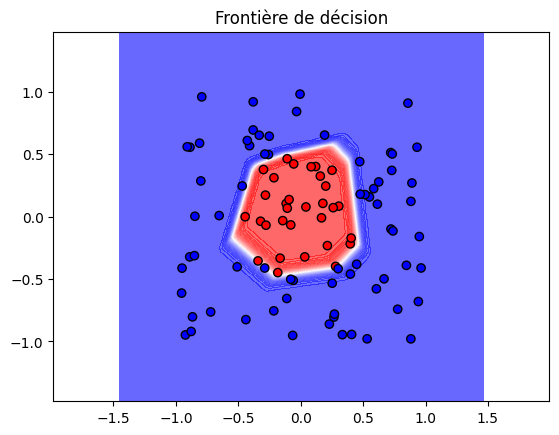

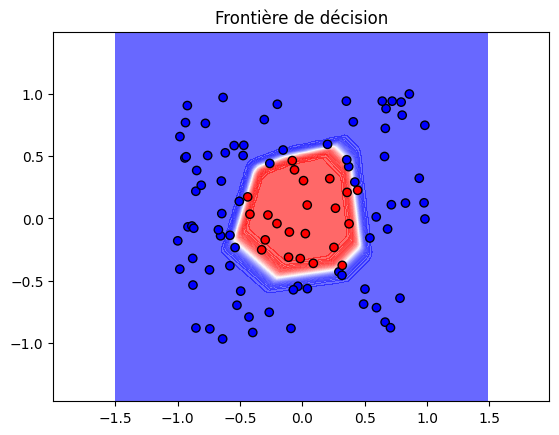

In [317]:
"""
Predit si point appartient à un cercle
"""

def generate_circle_data(nb_points=1000, radius=0.5):
    x = np.random.uniform(-1, 1, (nb_points, 2))
    targets = (np.sum(x**2, axis=1) < radius**2).astype(int).reshape(-1, 1)
    return x, targets

x_train, targets = generate_circle_data(100)


r = [0.00001, 0.001, 0.01, 0.1, 1, 10, 100]
r = [0.01]
for i, lr in enumerate(r):
    network = Network([
        Layer(neurons=[Neuron(nb_inputs=2, activation=LeakyReLU, grad_activation=grad_LeakyReLU) for _ in range(6)]),
        Layer(neurons=[Neuron(nb_inputs=6, activation=sigmoid, grad_activation=grad_sigmoid)])
    ],
    loss=cross_entropy,
    grad_loss=grad_cross_entropy
    )

    trainer = Trainer(network, x_train, targets, learning_rate=lr, nb_epochs=1000, epsilon=0.01, plot=True, verbose=False)
    print(f"lr = {lr}")
    # plt.subplot(3,3, i+1)
    # plt.subplots_adjust(wspace=1.5, hspace=1.3)
    trainer.train()
    

plt.show()
def plot_decision_boundary(network, x, targets, resolution=100):
    # 1. Définir les bornes du plan
    x_min, x_max = x[:,0].min() - 0.5, x[:,0].max() + 0.5
    y_min, y_max = x[:,1].min() - 0.5, x[:,1].max() + 0.5

    # 2. Créer une grille de points
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, resolution),
                         np.linspace(y_min, y_max, resolution))
    grid = np.c_[xx.ravel(), yy.ravel()]

    # 3. Prédire pour chaque point de la grille
    preds = np.array([network.forward(p)[0] for p in grid])
    preds = preds.reshape(xx.shape)

    # 4. Tracer la zone
    plt.contourf(xx, yy, preds, levels=50, cmap="bwr", alpha=0.6)

    # 5. Tracer les vrais points
    plt.scatter(x[:, 0], x[:, 1], c=targets[:, 0], cmap="bwr", edgecolor='k')
    plt.title("Frontière de décision")
    plt.axis('equal')
    plt.show()


def plot_boundary_circle(network, x):
    plt.scatter(x[:, 0], x[:,1], c=[network.forward(xi)[0] for xi in x], cmap='ocean', edgecolor='k')
    plt.colorbar(label="Sortie du réseau")
    circle = plt.Circle((0, 0), radius=0.5, edgecolor='red', facecolor='none', linewidth=2)
    plt.gca().add_patch(circle)
    plt.gca().set_aspect('equal')
    plt.show()
plot_boundary_circle(network, x_train)

x_test, y_test = generate_circle_data(100)

plot_boundary_circle(network, x_test)

plot_decision_boundary(network, x_train, targets)
plot_decision_boundary(network, x_test, y_test)


lr = 0.01
Epoch 1 - outputs: [0.9989114388121187, 0.6977399140417399, 1.0, 0.9998204562579585, 0.0018081244189349758, 0.9061091744542444, 0.017127236204899452, 3.676320400256945e-22, 0.6029422945937283, 6.643017855999671e-14, 1.327142876594008e-23, 0.00019773921792183512, 1.0475921424233187e-05, 0.6295110968265883, 0.0020627843386336877, 0.17093223564347806, 0.49114964640343717, 0.3463775763762006, 0.3865306245304477, 1.4042527898137383e-11, 5.585418674144924e-13, 0.0006757303989240643, 0.39392281454977474, 0.38386809906726127, 0.0022681119534543504, 0.03437002550321475, 0.00026984589346645984, 2.0619042740239123e-16, 3.1558238445094836e-09, 2.3344278169047437e-08, 0.0017701356399156508, 1.619202468658555e-21, 3.966614300502336e-13, 7.195594591141825e-08, 3.4288367952738703e-07, 0.37227606010738773, 5.476666502126854e-05, 1.286571960119034e-10, 0.2902646228831646, 0.1477683250172825, 0.3763413814969347, 1.5700289249242873e-10, 2.079177687691009e-07, 3.396512460482924e-07, 0.14532282714

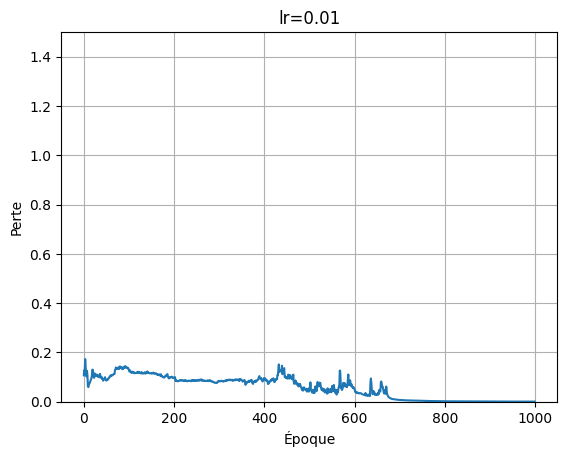

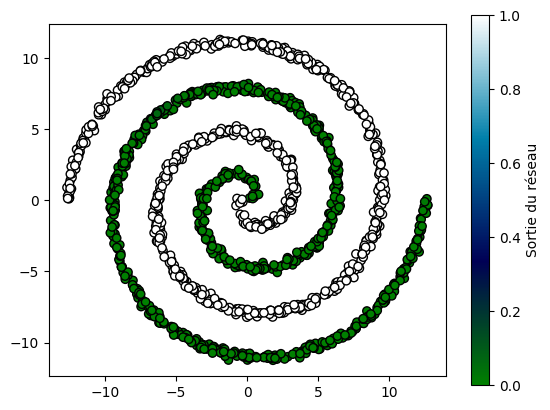

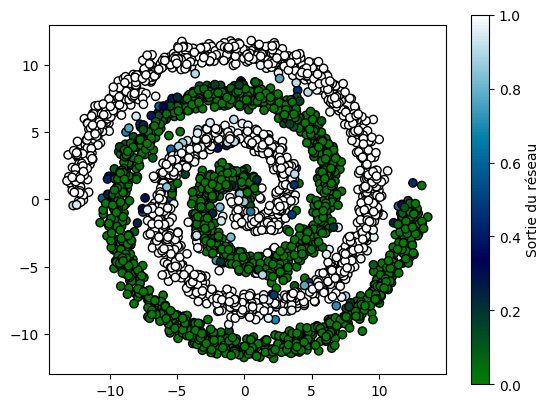

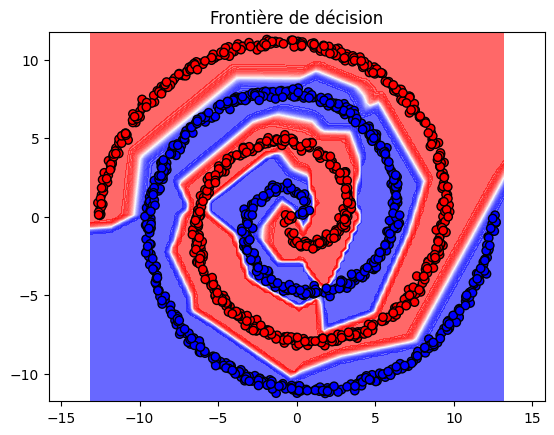

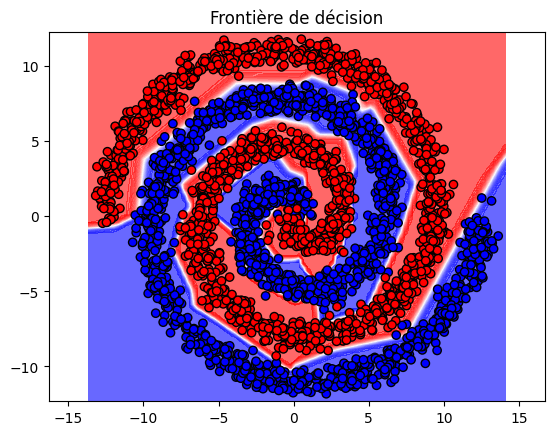

In [323]:
def generate_spiral_data(nb_points=1000, noise=0.1):
    n = nb_points // 2
    theta = np.sqrt(np.random.rand(n)) * 4 * np.pi  # angle progressif
    r = theta  # distance augmente avec theta

    # Spirale 1 (classe 0)
    x1 = np.array([r * np.cos(theta), r * np.sin(theta)]).T
    x1 += np.random.randn(n, 2) * noise
    y1 = np.zeros((n, 1))

    # Spirale 2 (classe 1) : opposée
    x2 = np.array([-r * np.cos(theta), -r * np.sin(theta)]).T
    x2 += np.random.randn(n, 2) * noise
    y2 = np.ones((n, 1))

    # Combine
    x = np.vstack((x1, x2))
    targets = np.vstack((y1, y2))
    return x, targets



x_train, targets = generate_spiral_data(nb_points= 1500, noise=0.15)

r = [0.01]
for i, lr in enumerate(r):
    network = Network([
        Layer([Neuron(2, LeakyReLU, grad_LeakyReLU) for _ in range(8)]),
        Layer([Neuron(8, LeakyReLU, grad_LeakyReLU) for _ in range(8)]),
        Layer([Neuron(8, sigmoid, grad_sigmoid)])
    ],
    loss=cross_entropy,
    grad_loss=grad_cross_entropy
    )

    trainer = Trainer(network, x_train, targets, learning_rate=lr, nb_epochs=1000, epsilon=0.0001, plot=True, verbose=True)
    print(f"lr = {lr}")
    # plt.subplot(3,3, i+1)
    # plt.subplots_adjust(wspace=1.5, hspace=1.3)
    trainer.train()
    

plt.show()

def plot_boundary(network, x):
    plt.scatter(x[:, 0], x[:,1], c=[network.forward(xi)[0] for xi in x], cmap='ocean', edgecolor='k')
    plt.colorbar(label="Sortie du réseau")
    plt.gca().set_aspect('equal')
    plt.show()

plot_boundary(network, x_train)

x_test, y_test = generate_spiral_data(nb_points=3000, noise=0.5)

plot_boundary(network, x_test)

plot_decision_boundary(network, x_train, targets)
plot_decision_boundary(network, x_test, y_test)
